Code written with my personal knowledge and a little help from Chat GPT

 # Do I keep reading lemon fanfictions on AO3 because I'm impressed by the linguistical complexity of their summary ? 

### **Author**: Tabara Guissé

### **Date**: January, 17th, 2025

As someone who has always loved reading, I stumbled upon one of the most popular online fiction website A03 as a young teen, and I am to this day still unsure about why I was reading stories made by 12 years old rather than some Shakespeare. So I've asked myself: even among all these A03 stories, did I at least pick them according to how well they seemed to be written ? 

### ***How does the linguistical complexity of the summary of a literary work on AO3 influence its popularity ?***

In a world where litterature has changed a lot, it seemed interesting to me to see if how well a literary work is written influences its popularity or if it is up to completely other factors. 

(As there is clear way to measure how well a summary is written I will talk about its linguistical complexity instead.)

To answer my question, I will use datas we scrapped last year about 276 395 original works on AO3. 
Using this dataset, I will test the following predictions:

### P1 - Works with a more complex summary are more likely to be read than others. 

### P2 - Works with a more complex summary are more likely to have more likes than others. 

### P3 - Works written in the 5 most used languages of the website are more likely to have a complex summary than others. 

To be sure that some external factors are not influencing the results I might obtain, I will also test if:  

### P4 - Works with more likes are more likely to be read than others. 

### P5- Works written in the 5 most used languages of the website are more likely to have more likes than others. 

### P6 - Works written in the 5 most used languages of the website are more likely to be read than others. 

## 0. Library import

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf

import re 

import networkx as nx
from scipy import stats

## Directed Acyclic Graph

To visualise my predictions better I create a DAG with the links I anticipate to observe between each of my explaining variables.

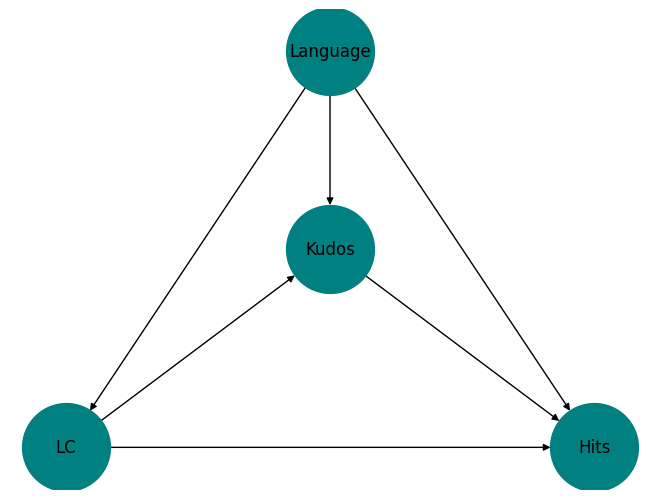

In [2]:
# Create a directed graph
G = nx.DiGraph()

# Add nodes
nodes = ['LC']
G.add_nodes_from(nodes)

# Add edges (directed connections)
edges = [('LC', 'Hits'), ('LC', 'Kudos'), ('Language', 'LC'), ('Kudos', 'Hits'), ('Language', 'Kudos'), ('Language', 'Hits')]
G.add_edges_from(edges)

# Draw the graph
pos = nx.planar_layout(G)
nx.draw(G, pos, with_labels = True, node_size = 4000, node_color ='teal', arrows = True)
plt.show()

## I. Data import

In [3]:
df = pd.read_csv('scraping_ao3_originalworks.csv')

/var/folders/ym/7rkb_dfj0mlf0zmyxlzqj0hw0000gn/T/ipykernel_4782/4164749884.py:1: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('scraping_ao3_originalworks.csv')


In [4]:
pd.set_option('display.max_rows', None)
df.head(10) 

,titre_auteur,id_work_id_author,fandoms,rating,relationship_orientation,completion_status,last_update,tag_warnings,tag_relationships,tag_characters,tag_other,summary,language,word_count,chapters,kudos,hits,comments,bookmarks,id_work
0,\nFamily Tradition - Date Night\nby\n\nCross_G...,"['/works/55316788', '/users/Cross_Generation_F...",['Sexual Family Traditions'],Explicit,['F/M'],Complete Work,2024-07-05 00:00:00,['Creator Chose Not To Use Archive Warnings'],['Mother-in-law Son-in-law'],"['John (Groom to be)', 'Alison (Bride to be)',...","['Sex', 'Vaginal Sex', 'Graphic Sex', 'Oral Se...",\nAlison belongs to a family with an unusual m...,English,7393.0,3/3,17.0,1994.0,NaN,5.0,/works/55316788
1,\nBest Friends and Mirrored Taboo\nby\n\nCross...,"['/works/55065370', '/users/Cross_Generation_F...",['Mom son - Fandom'],Explicit,['F/M'],Work in Progress,2024-07-05 00:00:00,['Underage'],['Mother and Son - Relationship'],"['Sally (Mother to Timmy)', 'Debbie (Mother to...","['Incest', 'Underage Sex', 'Mother Son Incest'...",\nSally gets tempted by the same taboo that he...,English,14014.0,3/?,30.0,6231.0,2,13.0,/works/55065370
2,\nRachel's Depraved Desires\nby\n\nAcross_The_...,"['/works/57139360', '/users/Across_The_Gentle_...",['Original Work'],Explicit,"['F/F', 'F/M']",Work in Progress,2024-07-05 00:00:00,['Creator Chose Not To Use Archive Warnings'],[''],[''],"['LGD', 'lesbian getting dicked', 'dyke conver...","\nRachel had a loving girlfriend, a great job,...",English,3620.0,1/?,NaN,0.0,NaN,NaN,/works/57139360
3,\nEternal Moon\nby\n\nFujikawaKenji\n,"['/works/57138565', '/users/FujikawaKenji/pseu...","['響け! ユーフォニアム | Hibike! Euphonium (Anime)', 'O...",Mature,['F/M'],Complete Work,2024-07-05 00:00:00,['Creator Chose Not To Use Archive Warnings'],['Hisaishi Kanade & Tsukinaga Motomu'],"['Hisaishi Kanade', 'Tsukinaga Motomu']","['First Time', 'Topping', 'Cunnilingus', 'Roug...",\ntldr: Kanade x Motomu smut and fluff short s...,English,808.0,13/13,NaN,1.0,NaN,NaN,/works/57138565
4,\nSerenity Grove Academy\nby\n\nPandoras_Quill\n,"['/works/57139312', '/users/Pandoras_Quill/pse...",['Original Work'],Mature,['No category'],Complete Work,2024-07-05 00:00:00,['Creator Chose Not To Use Archive Warnings'],[''],[''],"['Transformation', 'Hypnotism', 'Breasts']",\nMason is quiet nerdy boy at Serenity Grove A...,English,3799.0,1/1,NaN,0.0,NaN,NaN,/works/57139312
5,\nThe Fashion Show\nby\n\nCross_Generation_Fic...,"['/works/55831471', '/users/Cross_Generation_F...","['Dad daughter - Fandom', 'Man Girl']",Explicit,['F/M'],Complete Work,2024-07-05 00:00:00,['Underage'],"['father and daughter - Relationship', 'Man an...","['mr johnson', 'Susie Johnson', 'Chloe', 'Jess...","['Incest', 'Underage Sex', 'Man Girl Sex', 'Fa...",\nSusie and two of her best friends are having...,English,12731.0,4/4,89.0,12113.0,7,26.0,/works/55831471
6,"\nLexi, Jo & Freiheit\nby\n\nUlya0th\n","['/works/57050761', '/users/Ulya0th/pseuds/Uly...",['Original Work'],Teen And Up Audiences,['F/F'],Work in Progress,2024-07-05 00:00:00,['Creator Chose Not To Use Archive Warnings'],[''],[''],"['Science Fiction', 'Lesbian Character', 'Mind...",\nLexi ist zwar nur ein Hybrid der Kategorie B...,Deutsch,9783.0,5/?,NaN,2.0,NaN,NaN,/works/57050761
7,\nAn Adventurers Life\nby\n\nPh0enix_Queen\n,"['/works/57049561', '/users/Ph0enix_Queen/pseu...",['Original Work'],Explicit,"['M/M', 'Multi']",Work in Progress,2024-07-05 00:00:00,"['Graphic Depictions Of Violence', 'Rape/Non-C...",['Original Male Character/Original Male Charac...,[''],"['Dubious Consent', 'Porn With Plot', 'High Fa...","\nAdrian, a horny gay man wanders the world, s...",English,3719.0,2/?,NaN,162.0,NaN,1.0,/works/57049561
8,\n便利店\nby\n\nBubbler\n,"['/works/56176429', '/users/Bubbler/pseuds/Bub...",['Original Work'],Explicit,"['F/M', 'F/F']",Work in Progress,2024-07-05 00:00:00,['No Archive Warnings Apply'],[''],[''],"['Explicit Sexual Content', 'clitoral orgasm',...",\n“在便利店打工，是我的梦想。”可能致郁——————————从下一章开始，准备写F/F年上...,中文-普通话 國語

# II. Data manipulation

I narrow my dataset to **four columns**:
- **"summary"**: this column gives us the summaries of the original works on AO3. I need it to measure the **linguistical complexity of the summaries**.

- **"kudos"**: this column gives us the number of likes of each work, it shows the **popularity** of a work on AO3. 

- **"hits"**: this column gives us the number of times each work was read, it shows **the popularity** of a work on AO3. 

- **"language**": this column gives us the language in which each work is written. I will separate the different languages in two categories according to whether they are one of the 5 most used languages of the website or not. 

In [5]:
# Erase the missing data
df = df.dropna(subset=['summary','kudos','hits','language'])

In [6]:
# Keep only the studied data
columns_to_keep = [
    "kudos",  
    "hits",  
    "language", 
    "summary"
]

fd = df[columns_to_keep]


# Delete the empty raws
display(fd.columns)
fd = fd.dropna()

Index(['kudos', 'hits', 'language', 'summary'], dtype='object')

In [7]:
print(fd.columns)

Index(['kudos', 'hits', 'language', 'summary'], dtype='object')


### II.1 Create the variable "linguistical complexity of the summary"

From the original variable "summary", I create the variable "summary_linguistical_complexity" as a combination of three others variables: 

- the number of words of each summary (the longer a summary is, the more linguistical complex it should be)

- the average length of the sentences of each summary (long sentences are an indicaror of linguistical complexity). 

- the Type Token Ration (TTR) of each summary (TTR a tool to measure linguistical diversity, so it's a great indicator of linguistical complexity) 

I build my "summary_linguistical_complexity" variable as a ponderate sum of all these variables:

***summary_linguistical_complexity = 50% of the TTR + 30% of the average sentence length + 20% of the number of words***

Calculation of the word count:

In [8]:
#Create a function which returns the number of words of a random text
def count_words(text):
    return len(re.findall(r'\b\w+\b', text))

#Past the function on the summary column 
fd['word_count_summary'] = fd['summary'].apply(count_words)

print(fd)

          kudos       hits                             language  \
0          17.0     1994.0                              English   
1          30.0     6231.0                              English   
5          89.0    12113.0                              English   
8           4.0      230.0                            中文-普通话 國語   
9           1.0       36.0                              English   
12        457.0    53990.0                              English   
13        242.0     6895.0                              English   
18          1.0        0.0                              English   
20          1.0        9.0                              English   
21          1.0        1.0                              English   
22          1.0        5.0                              English   
23         73.0     2910.0                              English   
25          1.0      110.0                              English   
26         17.0     1264.0                              Englis

Calculation of the average sentence length:

In [9]:

# Create a function which returns the average length of the sentences of a random text
def avg_sentence_length(text):
    if pd.isna(text) or not isinstance(text, str):
        return 0
    sentences = re.split(r'[.!?]', text)
    sentences = [s.strip() for s in sentences if s.strip()]
    total_words = sum(len(s.split()) for s in sentences)
    return total_words / len(sentences) if len(sentences) > 0 else 0

# Apply the function on the "summary" column
fd['avg_sentence_length'] = fd['summary'].apply(avg_sentence_length)



Calculation of the TTR:

In [10]:
# Create a function which return the ttr of a random text
def compute_ttr(text):
    if pd.isna(text):  # Deal with missing values
        return 0
    tokens = text.split()  # Separate in words (tokens)
    types = set(tokens)    # Find the unique words (types)
    ttr = len(types) / len(tokens) if len(tokens) > 0 else 0  # Measuring TTR
    return ttr

# Add a column with the TTR

fd['TTR'] = fd['summary'].apply(compute_ttr)


In [11]:
pd.set_option('display.max_rows', None)
fd.head(10) 

,kudos,hits,language,summary,word_count_summary,avg_sentence_length,TTR
0,17.0,1994.0,English,\nAlison belongs to a family with an unusual m...,70,13.600000,0.764706
1,30.0,6231.0,English,\nSally gets tempted by the same taboo that he...,24,12.000000,0.958333
5,89.0,12113.0,English,\nSusie and two of her best friends are having...,36,17.500000,0.914286
8,4.0,230.0,中文-普通话 國語,\n“在便利店打工，是我的梦想。”可能致郁——————————从下一章开始，准备写F/F年上...,7,1.000000,1.000000
9,1.0,36.0,English,\nBEGINNER WRITER WARNING!A small creature aba...,129,17.857143,0.701613
12,457.0,53990.0,English,"\nFollowing an unfortunate accident, a man fin...",19,19.000000,0.947368
13,242.0,6895.0,English,\nThe hand gripping his arm didn’t release him...,166,14.454545,0.757962
18,1.0,0.0,English,\nyou can hug her every morning\n,6,6.000000,1.000000
20,1.0,9.0,English,\nMargot Rivera enjoyed her life. She had work...,228,16.071429,0.695067
21,1.0,1.0,English,\nHansel and Gretel along with Ben and Edward ...,73,24.000000,0.757143


In [12]:
#Add the columns calculated

fd['word_count_summary'] = fd['summary'].apply(count_words)
fd['TTR'] = fd['summary'].apply(compute_ttr)
fd['avg_sentence_length'] = fd['summary'].apply(avg_sentence_length)

#Gather the variable with differents weights 
fd['summary_linguistical_complexity'] = (
    0.20 * fd['word_count_summary'] + 
    0.50 * fd['TTR'] + 
    0.30 * fd['avg_sentence_length']
)

In [13]:
pd.set_option('display.max_rows', None)
fd.head(10) 

,kudos,hits,language,summary,word_count_summary,avg_sentence_length,TTR,summary_linguistical_complexity
0,17.0,1994.0,English,\nAlison belongs to a family with an unusual m...,70,13.600000,0.764706,18.462353
1,30.0,6231.0,English,\nSally gets tempted by the same taboo that he...,24,12.000000,0.958333,8.879167
5,89.0,12113.0,English,\nSusie and two of her best friends are having...,36,17.500000,0.914286,12.907143
8,4.0,230.0,中文-普通话 國語,\n“在便利店打工，是我的梦想。”可能致郁——————————从下一章开始，准备写F/F年上...,7,1.000000,1.000000,2.200000
9,1.0,36.0,English,\nBEGINNER WRITER WARNING!A small creature aba...,129,17.857143,0.701613,31.507949
12,457.0,53990.0,English,"\nFollowing an unfortunate accident, a man fin...",19,19.000000,0.947368,9.973684
13,242.0,6895.0,English,\nThe hand gripping his arm didn’t release him...,166,14.454545,0.757962,37.915345
18,1.0,0.0,English,\nyou can hug her every morning\n,6,6.000000,1.000000,3.500000
20,1.0,9.0,English,\nMargot Rivera enjoyed her life. She had work...,228,16.071429,0.695067,50.768962
21,1.0,1.0,English,\nHansel and Gretel along with Ben and Edward ...,73,24.000000,0.757143,22.178571


### II. 2. Creation of the binary variable "is_in_top_5_language"

In [14]:
print(df['language'].value_counts().head(5))


language
English       173641
Русский         8206
中文-普通话 國語       5027
Українська      1863
Français        1771
Name: count, dtype: int64


The works on AO3 are majoritarely written in English, Russian, Chinese, Ukrainian and French. I create a binary variable "is_in_top_5_language" which returns 1 if the work is written in one of the 5 most used languages and 0 if it is in another language.

In [15]:
# Count the most frequent languages 
top_5_languages = fd['language'].value_counts().head(5)

# Create a new binary column which says if the language is in top 5 
fd['is_in_top_5_language'] = fd['language'].apply(lambda x: 1 if x in top_5_languages.index else 0)

In [16]:
pd.set_option('display.max_rows', None)
fd.head(10) 

,kudos,hits,language,summary,word_count_summary,avg_sentence_length,TTR,summary_linguistical_complexity,is_in_top_5_language
0,17.0,1994.0,English,\nAlison belongs to a family with an unusual m...,70,13.600000,0.764706,18.462353,1
1,30.0,6231.0,English,\nSally gets tempted by the same taboo that he...,24,12.000000,0.958333,8.879167,1
5,89.0,12113.0,English,\nSusie and two of her best friends are having...,36,17.500000,0.914286,12.907143,1
8,4.0,230.0,中文-普通话 國語,\n“在便利店打工，是我的梦想。”可能致郁——————————从下一章开始，准备写F/F年上...,7,1.000000,1.000000,2.200000,1
9,1.0,36.0,English,\nBEGINNER WRITER WARNING!A small creature aba...,129,17.857143,0.701613,31.507949,1
12,457.0,53990.0,English,"\nFollowing an unfortunate accident, a man fin...",19,19.000000,0.947368,9.973684,1
13,242.0,6895.0,English,\nThe hand gripping his arm didn’t release him...,166,14.454545,0.757962,37.915345,1
18,1.0,0.0,English,\nyou can hug her every morning\n,6,6.000000,1.000000,3.500000,1
20,1.0,9.0,English,\nMargot Rivera enjoyed her life. She had work...,228,16.071429,0.695067,50.768962,1
21,1.0,1.0,English,\nHansel and Gretel along with Ben and Edward ...,73,24.000000,0.757143,22.178571,1


In [17]:
# Keep only the final data
columns_to_keep = [
    "kudos",  
    "hits",  
    "is_in_top_5_language", 
    "summary_linguistical_complexity"
]

final_dataset = fd[columns_to_keep]


# Delete the empty raws
display(final_dataset.columns)
final_dataset = final_dataset.dropna()

Index(['kudos', 'hits', 'is_in_top_5_language',
       'summary_linguistical_complexity'],
      dtype='object')

In [18]:
pd.set_option('display.max_rows', None)
final_dataset.head(10) 

,kudos,hits,is_in_top_5_language,summary_linguistical_complexity
0,17.0,1994.0,1,18.462353
1,30.0,6231.0,1,8.879167
5,89.0,12113.0,1,12.907143
8,4.0,230.0,1,2.200000
9,1.0,36.0,1,31.507949
12,457.0,53990.0,1,9.973684
13,242.0,6895.0,1,37.915345
18,1.0,0.0,1,3.500000
20,1.0,9.0,1,50.768962
21,1.0,1.0,1,22.178571


I have a new dataset with all the variables I want to work with. 

# IV. Data description

To visualize better the how each variable influence another I describe them in graphs which fit my predictions:

/var/folders/ym/7rkb_dfj0mlf0zmyxlzqj0hw0000gn/T/ipykernel_4782/892938687.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='is_in_top_5_language', y='hits', data=final_dataset, palette='Set2')
/var/folders/ym/7rkb_dfj0mlf0zmyxlzqj0hw0000gn/T/ipykernel_4782/892938687.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='is_in_top_5_language', y='kudos', data=final_dataset, palette='Set3')
/var/folders/ym/7rkb_dfj0mlf0zmyxlzqj0hw0000gn/T/ipykernel_4782/892938687.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='is_in_top_5_langua

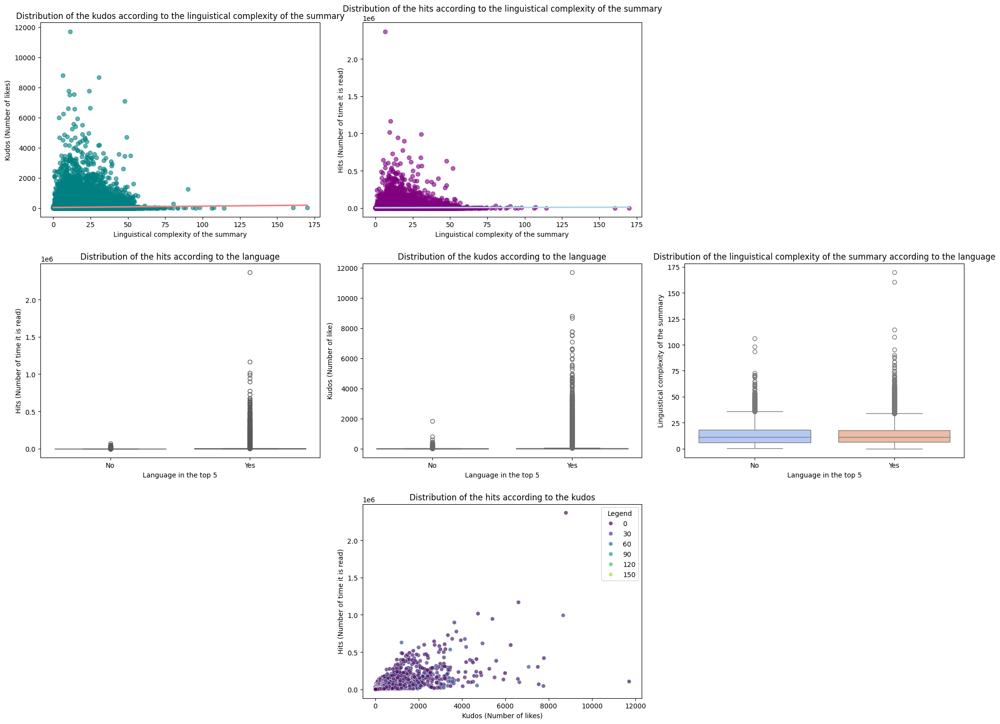

In [19]:
# Configurate the size of the figure
plt.figure(figsize=(20, 15))

# 1. Regplot : kudos according to summary_ling_complex (P2)
plt.subplot(3, 3, 1)  # Emplacement : First graph
sns.regplot(x='summary_linguistical_complexity', y='kudos', data=final_dataset, scatter_kws={'alpha': 0.6}, color='teal', line_kws={'color': 'lightcoral'})
plt.title('Distribution of the kudos according to the linguistical complexity of the summary')
plt.xlabel('Linguistical complexity of the summary')
plt.ylabel('Kudos (Number of likes)')

# 2. Regplot : hits according to summary_ling_complex (P1)
plt.subplot(3, 3, 2)  # Emplacement : 2nd graph
sns.regplot(x='summary_linguistical_complexity', y='hits', data=final_dataset, scatter_kws={'alpha': 0.6}, color='purple', line_kws={'color': 'lightblue'})
plt.title('Distribution of the hits according to the linguistical complexity of the summary')
plt.xlabel('Linguistical complexity of the summary')
plt.ylabel('Hits (Number of time it is read)')

# 3. Boxplot : hits according to is_in_top_5_language P(6)
plt.subplot(3, 3, 4)  # Position : 3rd graph
sns.boxplot(x='is_in_top_5_language', y='hits', data=final_dataset, palette='Set2')
plt.title('Distribution of the hits according to the language')
plt.xlabel('Language in the top 5')
plt.ylabel('Hits (Number of time it is read)')
plt.xticks(ticks=[0, 1], labels=['No', 'Yes'])

# 4. Boxplot : kudos according to is_in_top_5_language (P5)
plt.subplot(3, 3, 5)  # Emplacement : 4th graph
sns.boxplot(x='is_in_top_5_language', y='kudos', data=final_dataset, palette='Set3')
plt.title('Distribution of the kudos according to the language')
plt.xlabel('Language in the top 5')
plt.ylabel('Kudos (Number of like)')
plt.xticks(ticks=[0, 1], labels=['No', 'Yes'])

# 5. Boxplot : summary_ling_complex according to is_in_top_5_language (P3)
plt.subplot(3, 3, 6)  # Emplacement : 5th graph
sns.boxplot(x='is_in_top_5_language', y='summary_linguistical_complexity', data=final_dataset, palette='coolwarm')
plt.title('Distribution of the linguistical complexity of the summary according to the language')
plt.xlabel('Language in the top 5')
plt.ylabel('Linguistical complexity of the summary')
plt.xticks(ticks=[0, 1], labels=['No', 'Yes'])

# 6. Scatterplot : Hits vs Kudos (P4)
plt.subplot(3, 3, 8)  # Emplacement : 6th graph
sns.scatterplot(x='kudos', y='hits', data=final_dataset, hue='summary_linguistical_complexity', palette='viridis', alpha=0.7)
plt.title('Distribution of the hits according to the kudos')
plt.xlabel('Kudos (Number of likes)')
plt.ylabel('Hits (Number of time it is read)')
plt.legend(title='Legend')

# Adjust how the graphs are spaced
plt.tight_layout()

# Display all the graphs
plt.show()


# IV. Data Modelling 

### Multivariate linear regression to test predictions P1 and P4:
### - P1 - Works with a more complex summary are more likely to be read
### - P4 - Work with more likes than others are more likely to be read

In [20]:
model = smf.ols(formula = 'hits ~ summary_linguistical_complexity + kudos', data = final_dataset).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   hits   R-squared:                       0.534
Model:                            OLS   Adj. R-squared:                  0.534
Method:                 Least Squares   F-statistic:                 1.132e+05
Date:                Thu, 16 Jan 2025   Prob (F-statistic):               0.00
Time:                        18:39:06   Log-Likelihood:            -2.1093e+06
No. Observations:              197322   AIC:                         4.219e+06
Df Residuals:                  197319   BIC:                         4.219e+06
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
===================================================================================================
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept                         148.6090     41.723      3.562      0.000      66.833     230.385
summary_linguistical_complexity   -18.5423      2.560     -7.243      0.000     -23.560     -13.525
kudos                              70.6851      0.149    475.429      0.000      70.394      70.977
==============================================================================
Omnibus:                   545360.785   Durbin-Watson:                   1.980
Prob(Omnibus):                  0.000   Jarque-Bera (JB):     171722056527.402
Skew:                          34.312   Prob(JB):                         0.00
Kurtosis:                    4572.640   Cond. No.                         290.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The r-squared is 53% which fairly explains the variance of the variables (47% of the variance is left unexplained by the model)

The results indicate that, as I predicted, the number of likes of a literary work does influence significantly and positively the number of time it is read (coef>0, p-value=0.000<0.05). My prediction P4 appears to be accurate. 

Howeber, while the linguistical complexity of its summary does significantly influence the number of time a work is read (p-value=0.00>0.05), its influence is negative and not positive as I predicted (coef<0). Thus the results indicate the contrary of my prediction P1. 


## We conduct a simple linear regression to test prediction P2: Works with a more complex summary are more likely to have more likes than others

In [21]:
model = smf.ols(formula = 'kudos ~ summary_linguistical_complexity', data = final_dataset).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  kudos   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     530.4
Date:                Thu, 16 Jan 2025   Prob (F-statistic):          3.33e-117
Time:                        18:39:06   Log-Likelihood:            -1.2825e+06
No. Observations:              197322   AIC:                         2.565e+06
Df Residuals:                  197320   BIC:                         2.565e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===================================================================================================
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Intercept                          28.6981      0.628     45.665      0.000      27.466      29.930
summary_linguistical_complexity     0.8915      0.039     23.030      0.000       0.816       0.967
==============================================================================
Omnibus:                   410794.182   Durbin-Watson:                   1.949
Prob(Omnibus):                  0.000   Jarque-Bera (JB):       2945541217.273
Skew:                          17.664   Prob(JB):                         0.00
Kurtosis:                     600.507   Cond. No.                         28.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The r-squared is 0,3% which doesn't explain at all the variance of the model (might be the lowest r-squared i've ever seen I've almost mistaken it for a p-value).

The results indicate that, as I predicted, the linguistical complexity of a summary does influence significantly and positively the number of likes the story has (coef>0, p-value=0.000<0.05). My prediction P2 appears to be accurate. 


### T-test to test prediction P3: Works written in the 5 most used languages of the website are more likely to have a complex summary than others

In [22]:
# Separate the two groups according to the variable "is_in_top_5_languages"
summary_linguistical_complexity_top_5 = final_dataset[final_dataset['is_in_top_5_language'] == 1]['summary_linguistical_complexity'].dropna()
summary_linguistical_complexity_other = final_dataset[final_dataset['is_in_top_5_language'] == 0]['summary_linguistical_complexity'].dropna()

# Perform the t-test to compare the means of the two groups 
t_statistic, p_value = stats.ttest_ind(summary_linguistical_complexity_top_5, summary_linguistical_complexity_other)

# Display results
print(f"t-stat: {t_statistic:.4f}")
print(f"p-value: {p_value:.4f}")

# Display the means of each group
print(f"Mean of the summary complexity in the top 5 languages: {summary_linguistical_complexity_top_5.mean():.4f}")
print(f"Mean of the summary complexity in the other languages: {summary_linguistical_complexity_other.mean():.4f}")

t-stat: -3.1194
p-value: 0.0018
Mean of the summary complexity in the top 5 languages: 13.2571
Mean of the summary complexity in the other languages: 13.6168


The result indicate that, as I predicted, whether of not a work is written in one of the 5 most used languages of the website does significantly influence the linguistical complexity of its summary (p-value=0.0018<0.05). 
However, contrary to what I was expecting, the stories written in another language than the 5 most used languages are more likely to have a complex summary (the mean of the summary complexity is higher when it is written in the other languages)

Thus the results indicate the contrary of my prediction P3. 

### T-test to test prediction P5: Works written in the 5 most used languages of the website are more likely to have more likes than others

In [23]:
# Separate the two groups according to the variable "is_in_top_5_languages"
kudos_top_5 = final_dataset[final_dataset['is_in_top_5_language'] == 1]['kudos'].dropna()
kudos_other = final_dataset[final_dataset['is_in_top_5_language'] == 0]['kudos'].dropna()

# Perform the t-test to compare the means of the two groups
t_statistic, p_value = stats.ttest_ind(kudos_top_5, kudos_other)

# Display results
print(f"t-stat: {t_statistic:.4f}")
print(f"p-value: {p_value:.4f}")

# Display the means of each group
print(f"Mean of the kudos in the top 5 languages: {kudos_top_5.mean():.4f}")
print(f"Mean of the kudos in the other languages: {kudos_other.mean():.4f}")

t-stat: 17.5185
p-value: 0.0000
Mean of the kudos in the top 5 languages: 41.7277
Mean of the kudos in the other languages: 6.9680


The result indicate that, as I predicted, whether of not a work is written in one of the 5 most used languages of the website does positively and significantly influence the number of likes it gets (the mean of the number of likes is higher when the story is written in one of the top 5 language and the difference is significative as p-value=0.000<0.05)

My prediction P5 appears to be accurate. 

### T-test to test prediction P6: Works written in the 5 most used languages of the website are more likely to be read than others.

In [24]:
# Separate the two groups according to the variable "is_in_top_5_languages"
hits_top_5 = final_dataset[final_dataset['is_in_top_5_language'] == 1]['hits'].dropna()
hits_other = final_dataset[final_dataset['is_in_top_5_language'] == 0]['hits'].dropna()

# Perform the t-test to compare the means of the two groups
t_statistic, p_value = stats.ttest_ind(hits_top_5, hits_other)

# Display results
print(f"t-stat: {t_statistic:.4f}")
print(f"p-value: {p_value:.4f}")

print(f"Mean of the hits in the top 5 languages: {hits_top_5.mean():.4f}")
print(f"Mean of the hits in the other languages: {hits_other.mean():.4f}")


t-stat: 13.2893
p-value: 0.0000
Mean of the hits in the top 5 languages: 2855.2734
Mean of the hits in the other languages: 306.1399


The result indicate that, as I predicted, whether of not a work is written in one of the 5 most used languages of the website does positively and significantly influence the number of time it is read (the mean of the number of likes is higher when the story is written in one of the top 5 language and the difference is significative as p-value=0.000<0.05)

My prediction P6 appears to be accurate. 

**IN SUMMARY**, the results indicate that: 

- P1 is inaccurate, it is the contrary: Works with a **less** complex summary are more likely to be read than others. 

- P2 is accurate: Works with a more complex summary are more likely to have more likes than others.

- P3 is inaccurate, it is the contrary: Works written in **other languages** than the 5 more used of the website are more likely to have a complex summary than others.

- P4 is accurate: Works with more likes are more likely to be read than others.

- P5 is accurate: Works written in the 5 most used languages of the website are more likely to be read than others. 

Our dataset indicates that, contrary to my predictions, AO3 works with a less complex summary are more likely to be read than others. As the works with more likes are more likely to be read we can exclude the hypothesis that our results are a simple correlation. Moreover, as we predicted, the stories with a more complex summary are more likely to be liked.  

Contrary to our predictions, the stories written in another language than one of the 5 most used languages are more likely to have a linguistically complex summary. They are also less likely to have many likes and to be read many times. Once again these opposite results indicate that we are not observing a simple correlation. 

# V. Conclusion

### Readers selection behavior seem to depend on many more factors that we anticipated. 
### This study has shown that when searching for something to read on AO3, people are more likely to select the stories which seem to be less well-written than others, but they still enjoy them more when they are better written. Whereas the works on the website are majoritarely in the five same languages, it appears that the stories in another language are more likely to have a complex summary - maybe because the people who write them don't need to appeal to the majority, as opposed to the thousands of English or Russian writers on the website. 

### Or perhaps we could argue that how well a summary is written is not stricly the same as its linguistical complexity - they say that a few words speak louder than many, maybe simple words, short sentences and non diverse texts touch people better than the back cover of *À la recherche du temps perdu*. 